In [3]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.layers import Dense, Dropout, Flatten
from tensorflow.keras.models import Model


In [4]:

# Set paths for training data
train_data_dir = 'Train'
validation_data_dir = 'Validation'

# Define image preprocessing parameters
img_height, img_width = 224, 224
batch_size = 32

# Create data generators for training and validation
train_datagen = ImageDataGenerator(rescale=1./255, shear_range=0.2, zoom_range=0.2, horizontal_flip=True)

train_generator = train_datagen.flow_from_directory(train_data_dir, target_size=(img_height, img_width), batch_size=batch_size, class_mode='binary')

validation_datagen = ImageDataGenerator(rescale=1./255)

validation_generator = validation_datagen.flow_from_directory(validation_data_dir, target_size=(img_height, img_width), batch_size=batch_size, class_mode='binary')



Found 1910 images belonging to 2 classes.
Found 100 images belonging to 2 classes.


In [ ]:
import os
from PIL import Image
# Load pre-trained MobileNetV2 model and freeze convolutional base
base_model = MobileNetV2(input_shape=(img_height, img_width, 3), include_top=False, weights='imagenet')
base_model.trainable = False

# Add custom classification layers
x = base_model.output
x = Flatten()(x)
x = Dense(128, activation='relu')(x)
x = Dropout(0.5)(x)
predictions = Dense(1, activation='sigmoid')(x)

# Create new model
model = Model(inputs=base_model.input, outputs=predictions)
# Check if the file is an image
def is_image(file_path):
    try:
        Image.open(file_path)
        return True
    except IOError:
        return False

# Validate all images in the directory
def validate_images(directory):
    for filename in os.listdir(directory):
        file_path = os.path.join(directory, filename)
        if not is_image(file_path):
            print(f"Invalid image file: {file_path}")

# Validate images in training and validation directories
validate_images(train_data_dir)
validate_images(validation_data_dir)
# Save the trained model
model.save('cat_dog_model.h5')

In [6]:
import os
import cv2
import tensorflow as tf
import numpy as np
from tensorflow.keras.preprocessing import image
from IPython.display import Image, display



1/1 [==============================] - 0s 341ms/step


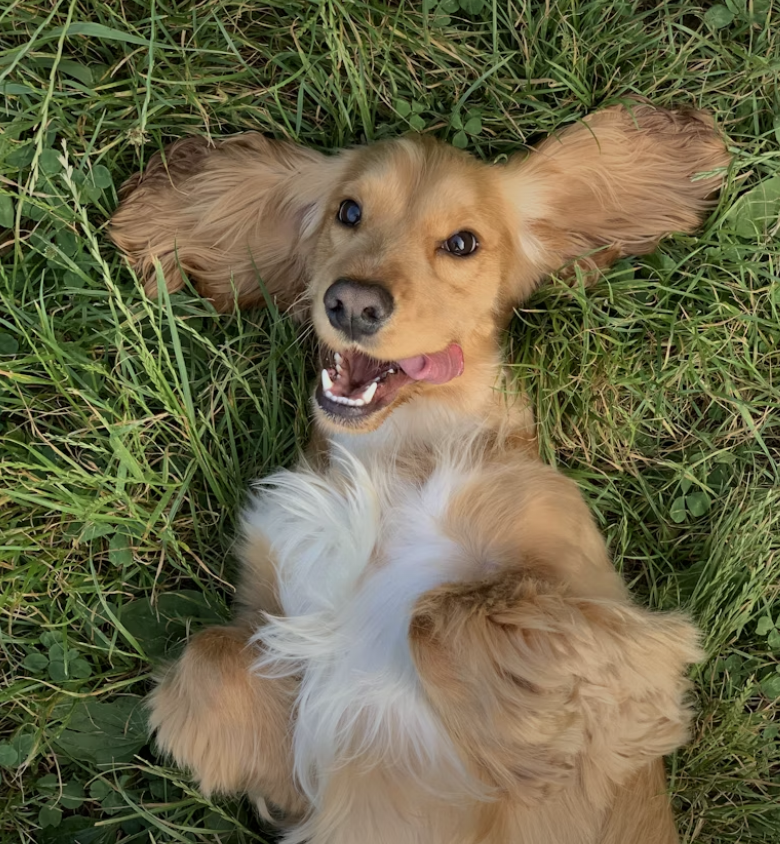

Predicted: dog
1/1 [==============================] - 0s 23ms/step


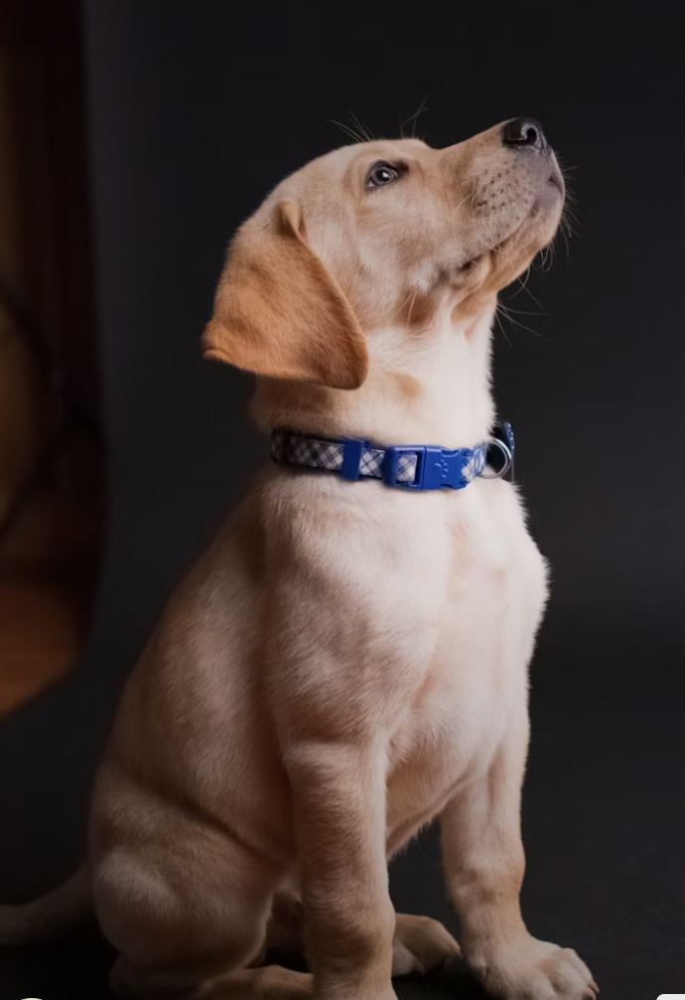

Predicted: dog
1/1 [==============================] - 0s 25ms/step


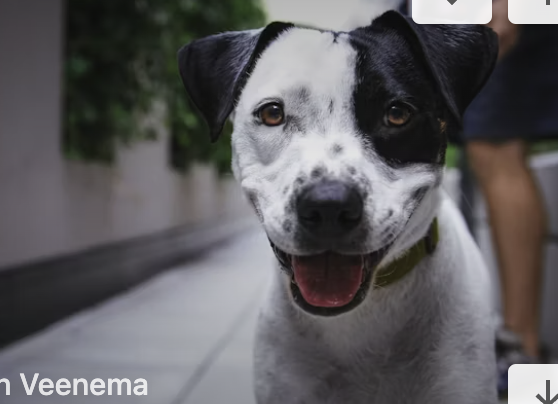

Predicted: dog
1/1 [==============================] - 0s 24ms/step


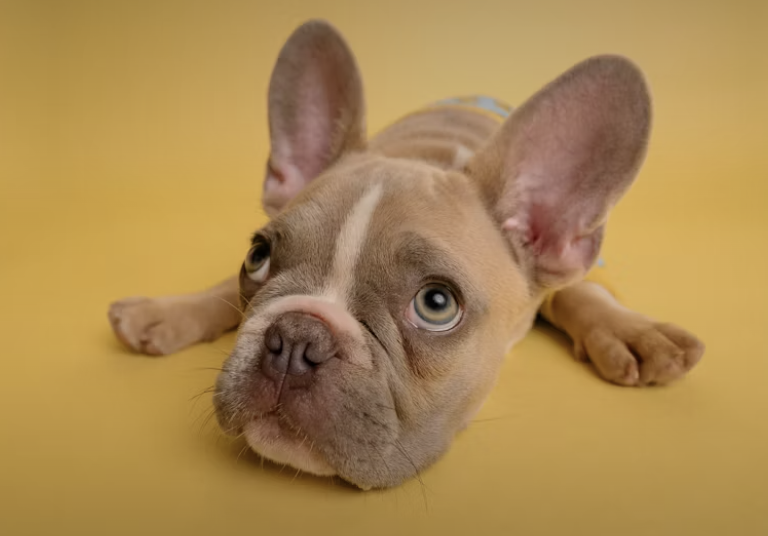

Predicted: dog
1/1 [==============================] - 0s 21ms/step


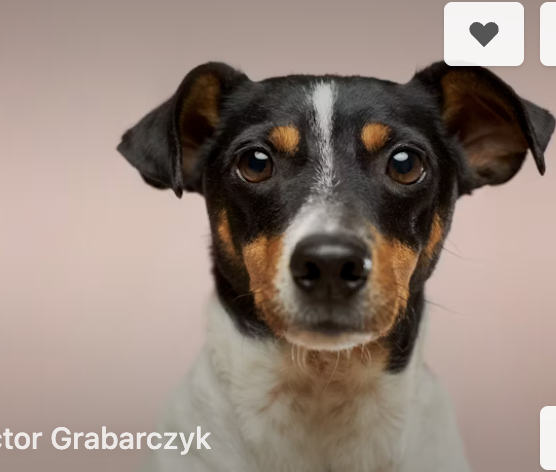

Predicted: cat
1/1 [==============================] - 0s 22ms/step


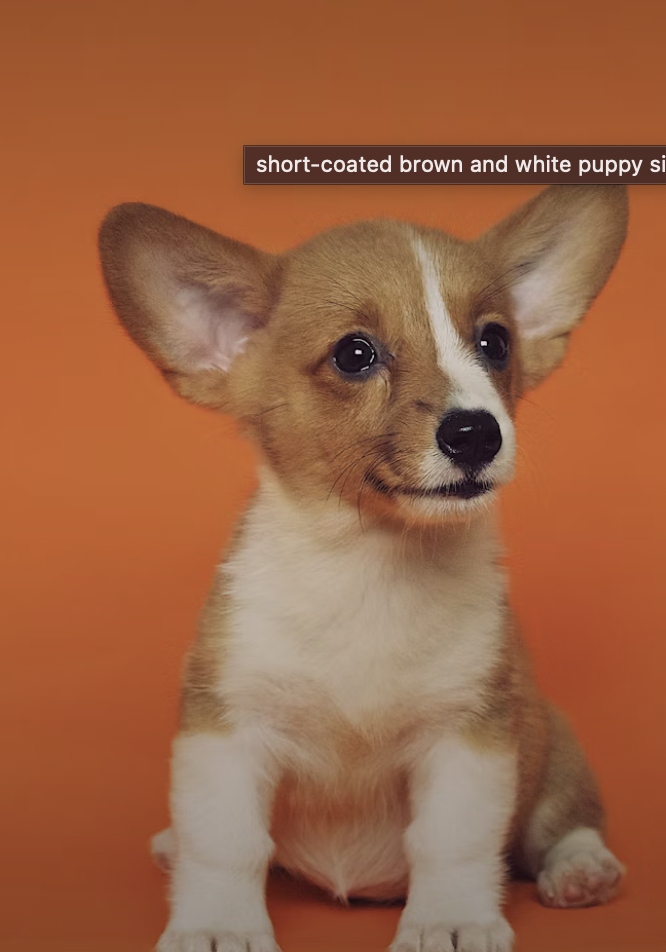

Predicted: dog
1/1 [==============================] - 0s 23ms/step


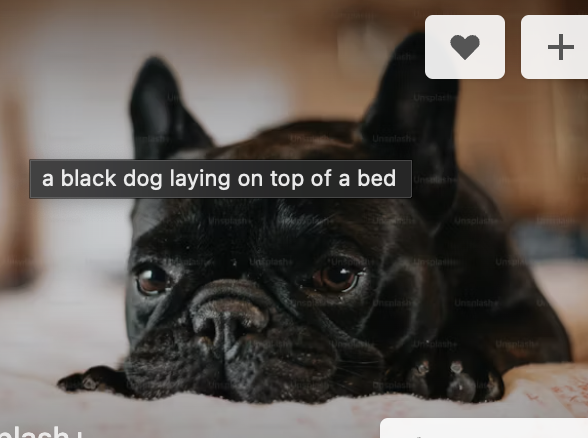

Predicted: cat
1/1 [==============================] - 0s 22ms/step


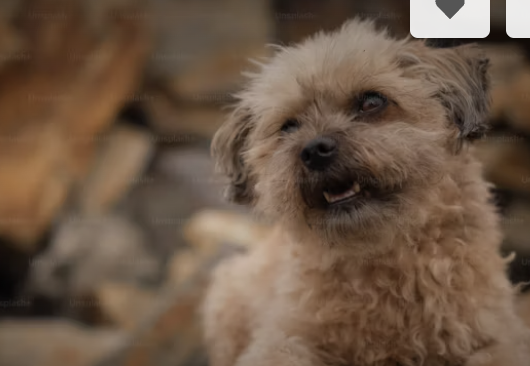

Predicted: dog
1/1 [==============================] - 0s 22ms/step


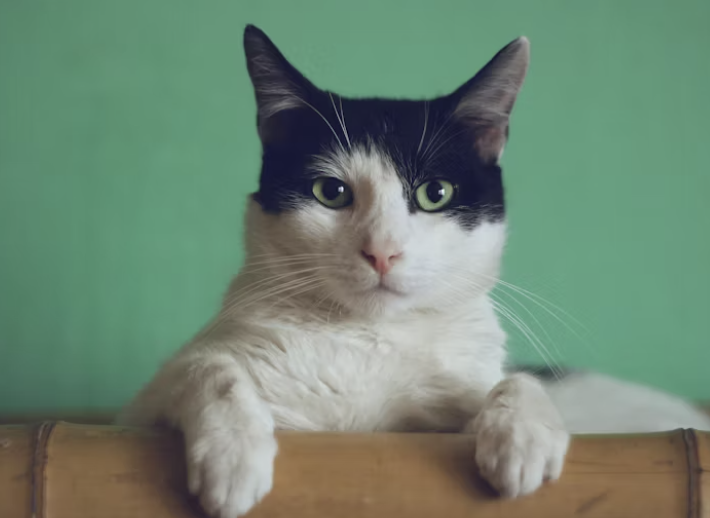

Predicted: cat
1/1 [==============================] - 0s 22ms/step


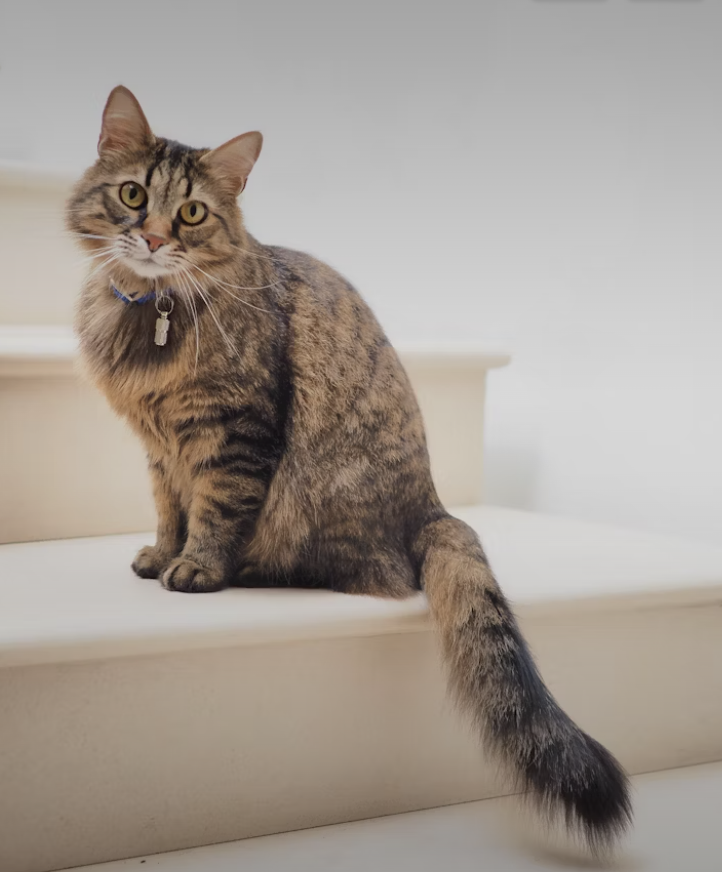

Predicted: cat
1/1 [==============================] - 0s 24ms/step


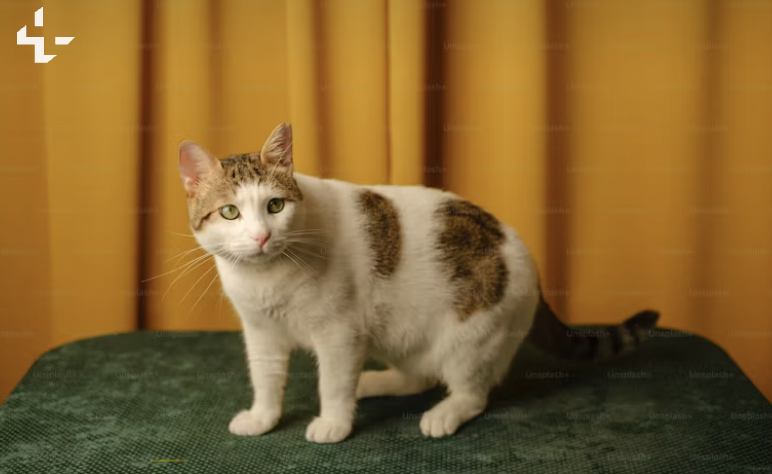

Predicted: dog
1/1 [==============================] - 0s 23ms/step


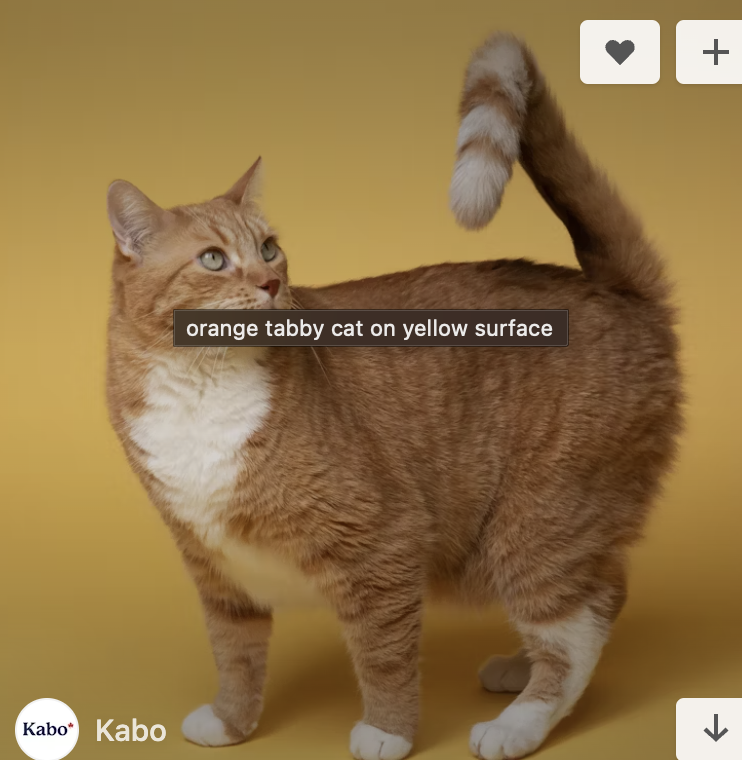

Predicted: dog
1/1 [==============================] - 0s 23ms/step


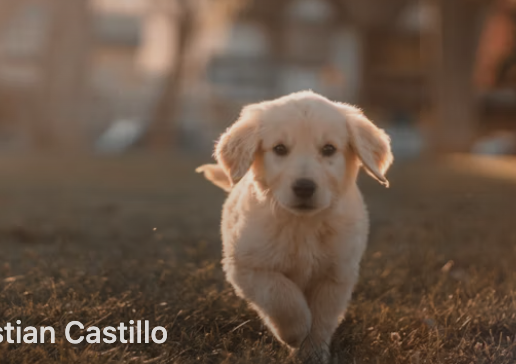

Predicted: dog
1/1 [==============================] - 0s 22ms/step


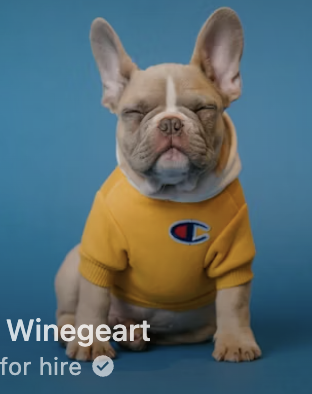

Predicted: cat
1/1 [==============================] - 0s 23ms/step


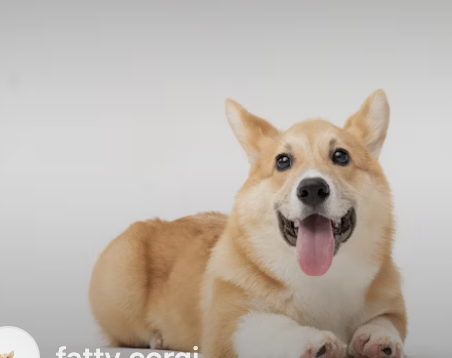

Predicted: dog
1/1 [==============================] - 0s 25ms/step


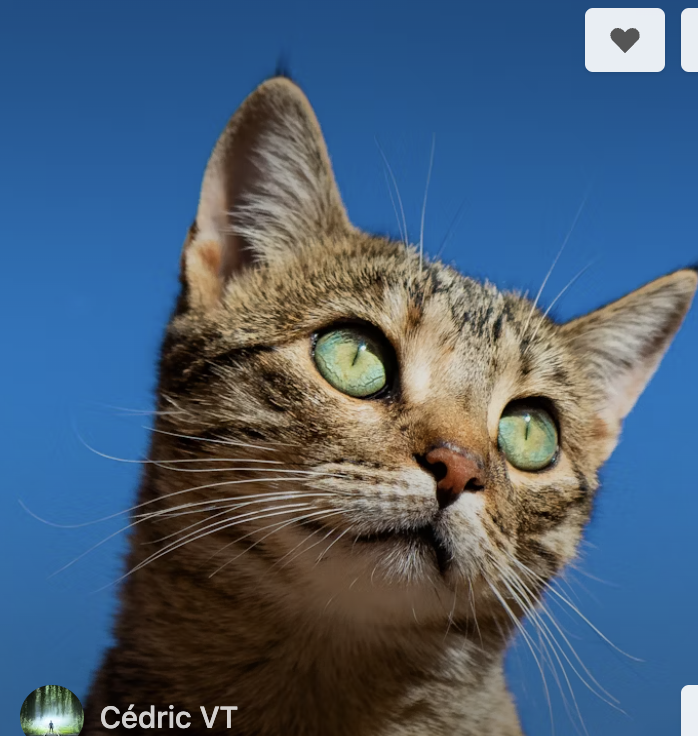

Predicted: cat
1/1 [==============================] - 0s 22ms/step


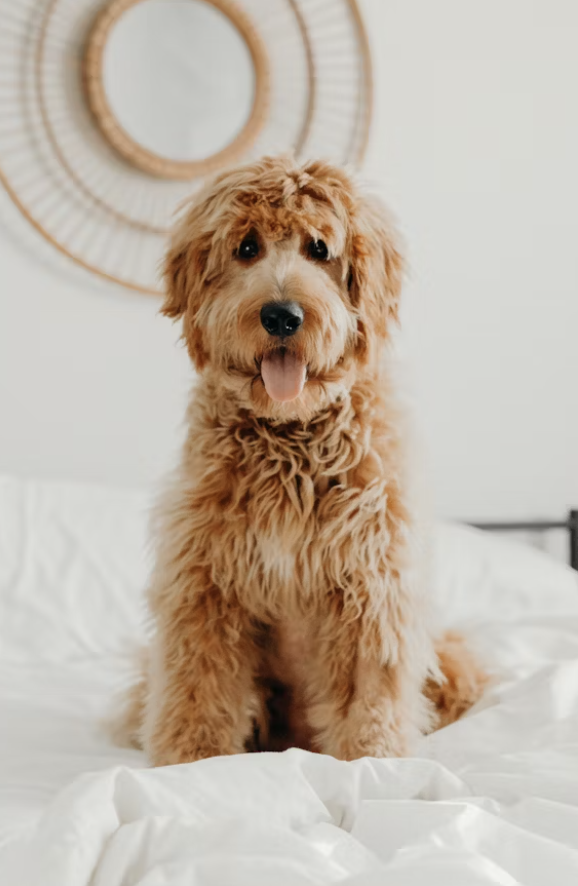

Predicted: dog
1/1 [==============================] - 0s 23ms/step


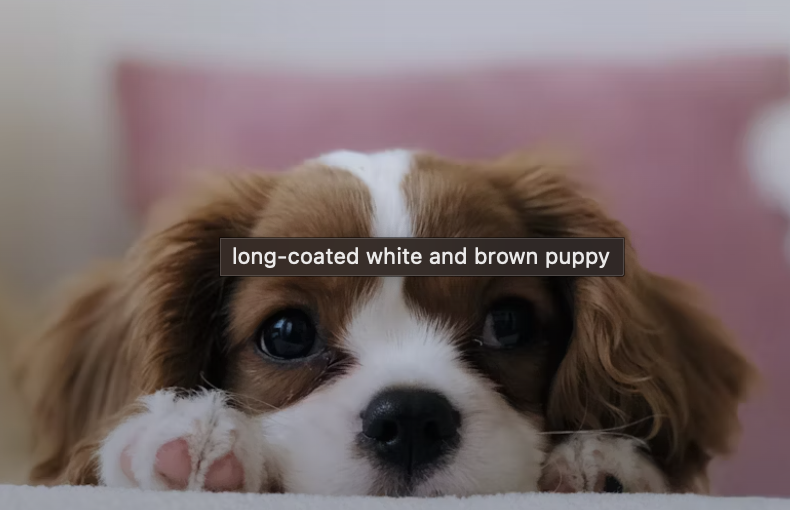

Predicted: dog
1/1 [==============================] - 0s 23ms/step


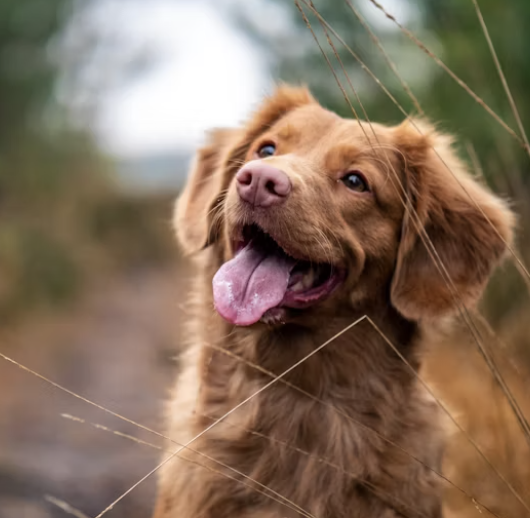

Predicted: dog
1/1 [==============================] - 0s 22ms/step


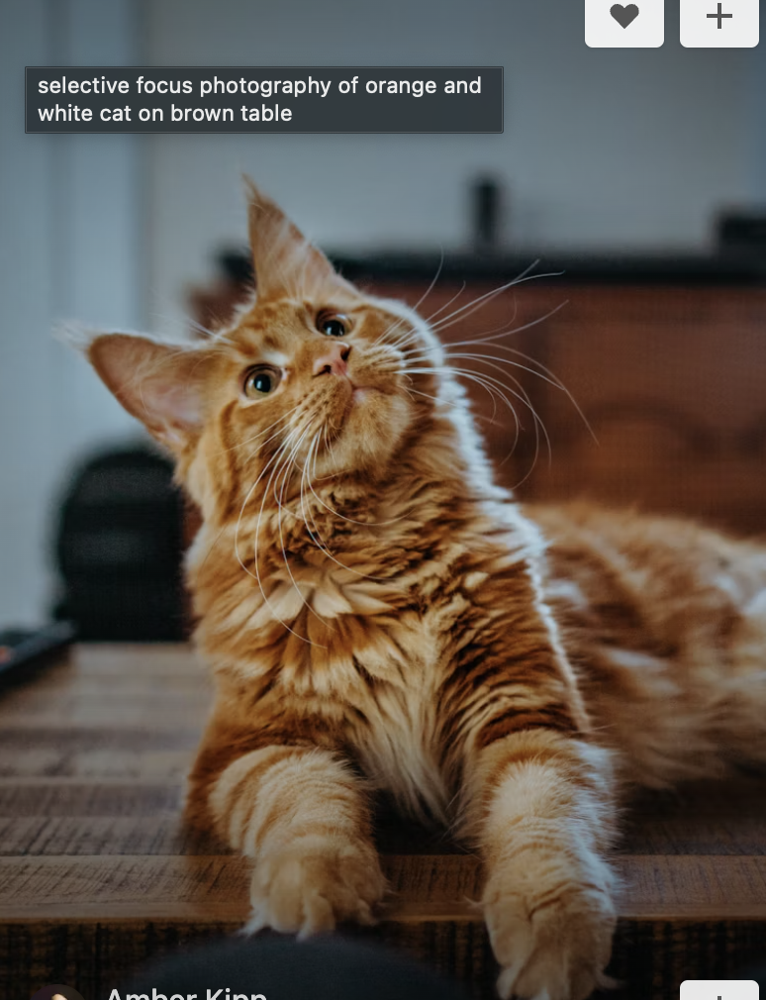

Predicted: cat
1/1 [==============================] - 0s 34ms/step


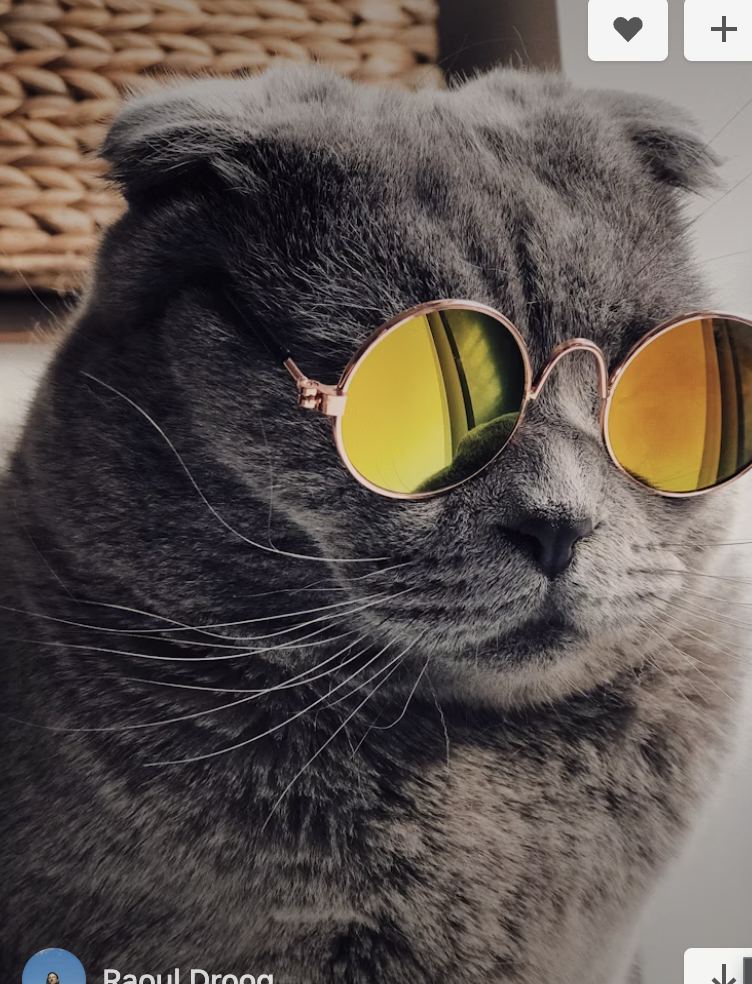

Predicted: dog
1/1 [==============================] - 0s 22ms/step


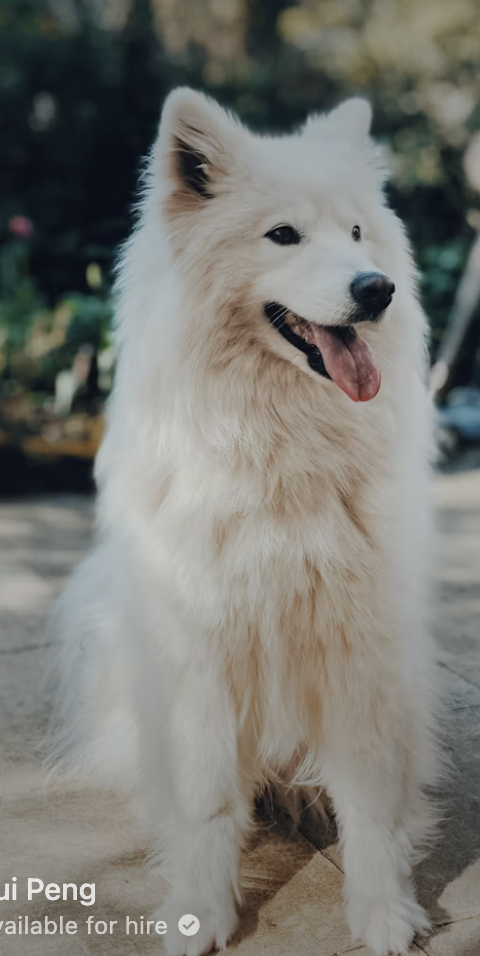

Predicted: cat
1/1 [==============================] - 0s 24ms/step


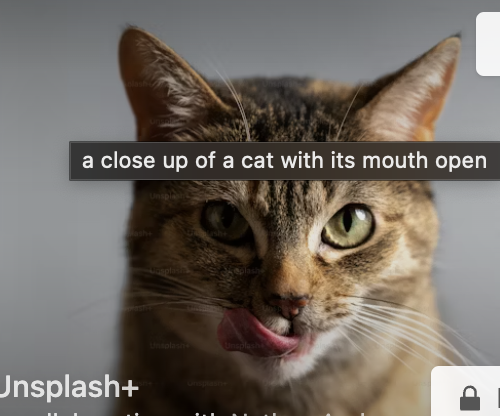

Predicted: dog
1/1 [==============================] - 0s 22ms/step


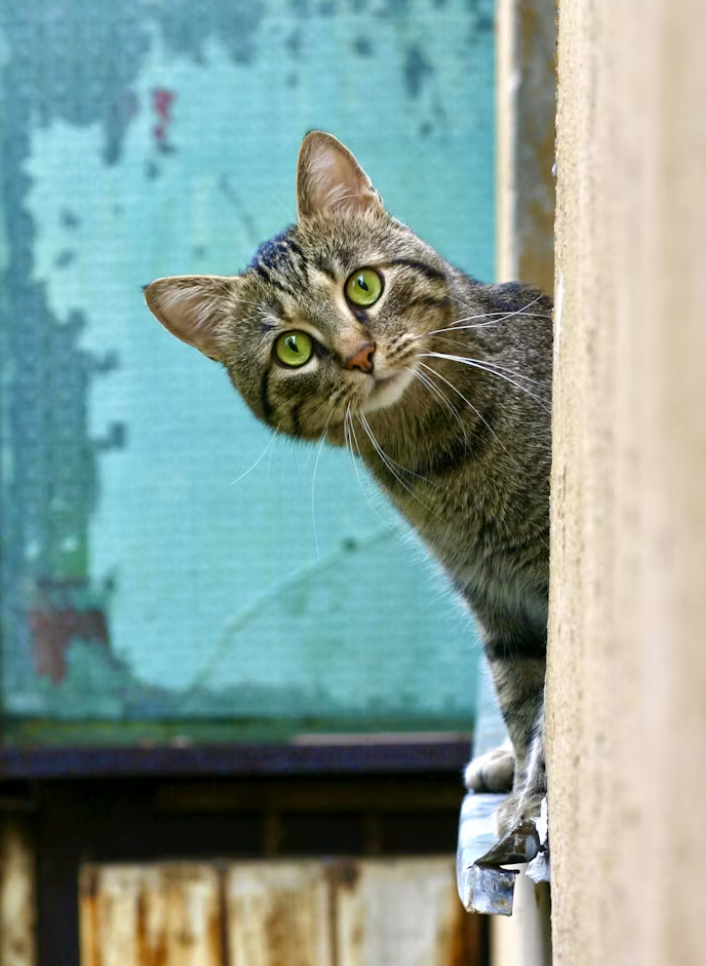

Predicted: dog
1/1 [==============================] - 0s 24ms/step


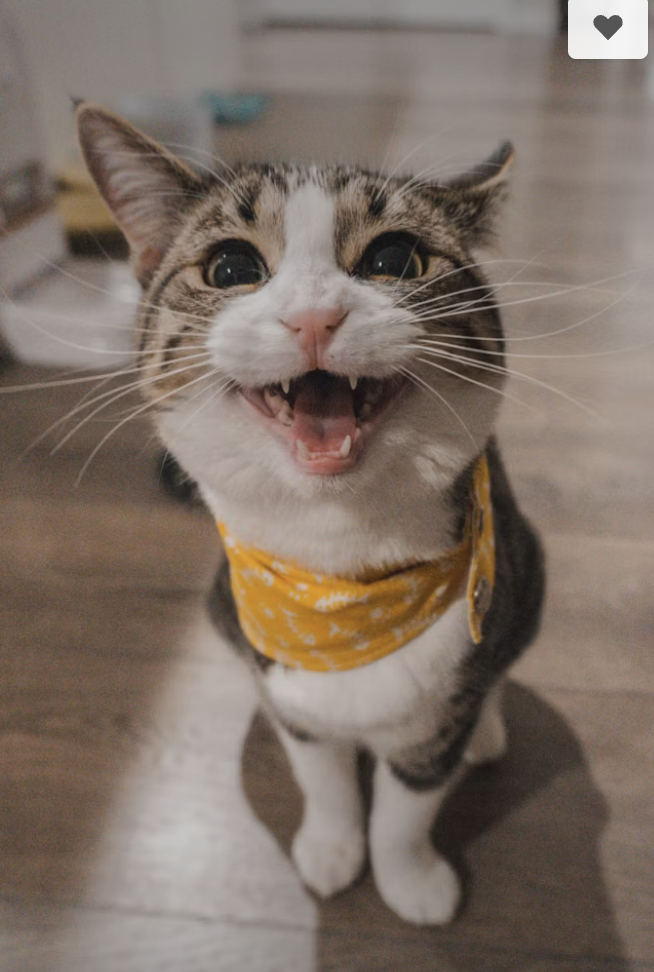

Predicted: dog
1/1 [==============================] - 0s 23ms/step


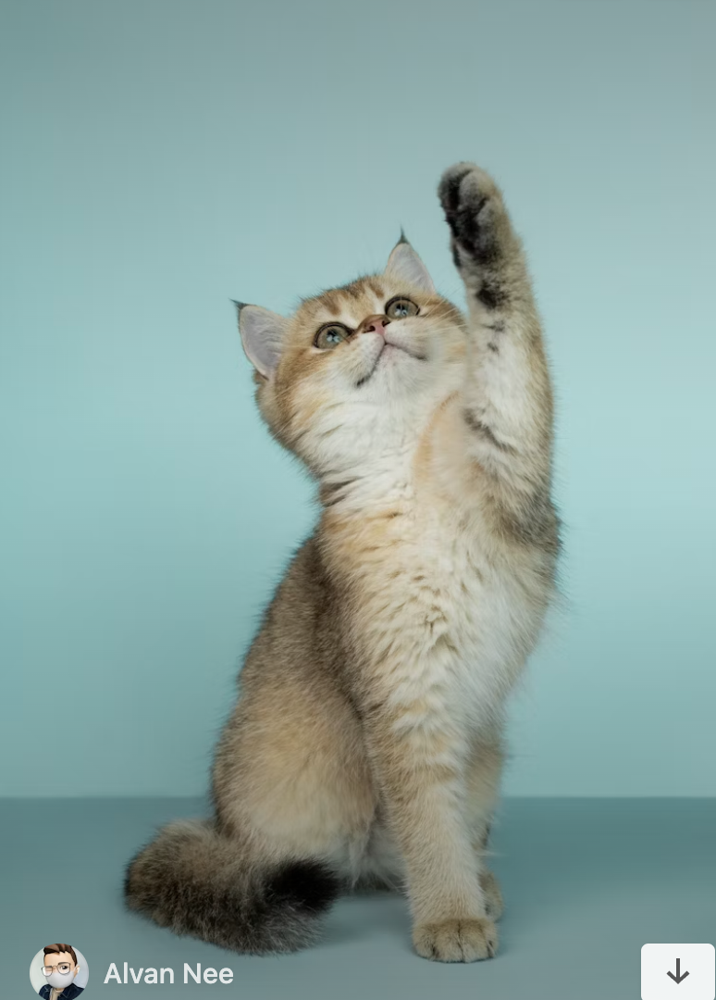

Predicted: dog
1/1 [==============================] - 0s 23ms/step


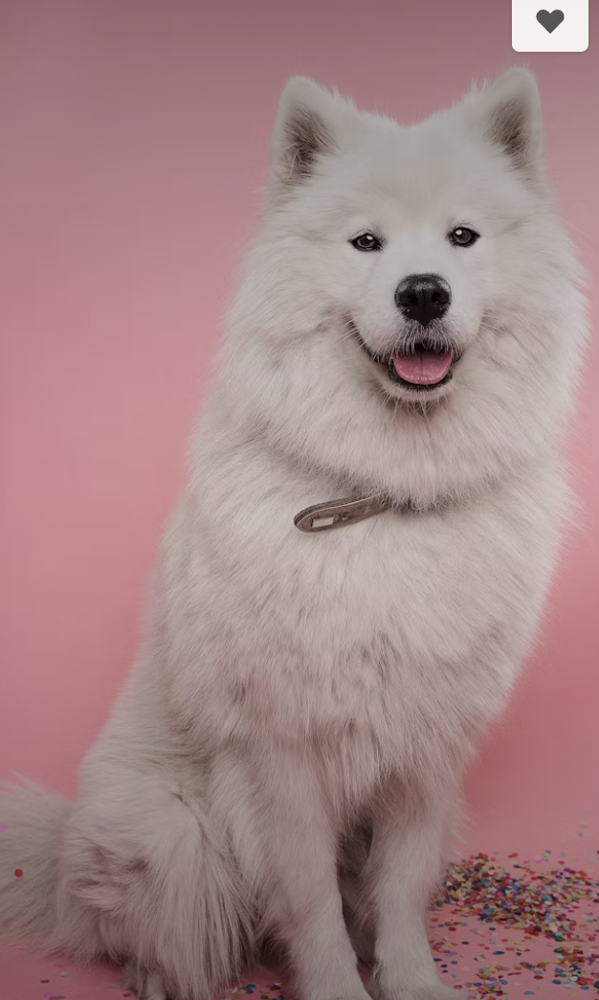

Predicted: cat
1/1 [==============================] - 0s 25ms/step


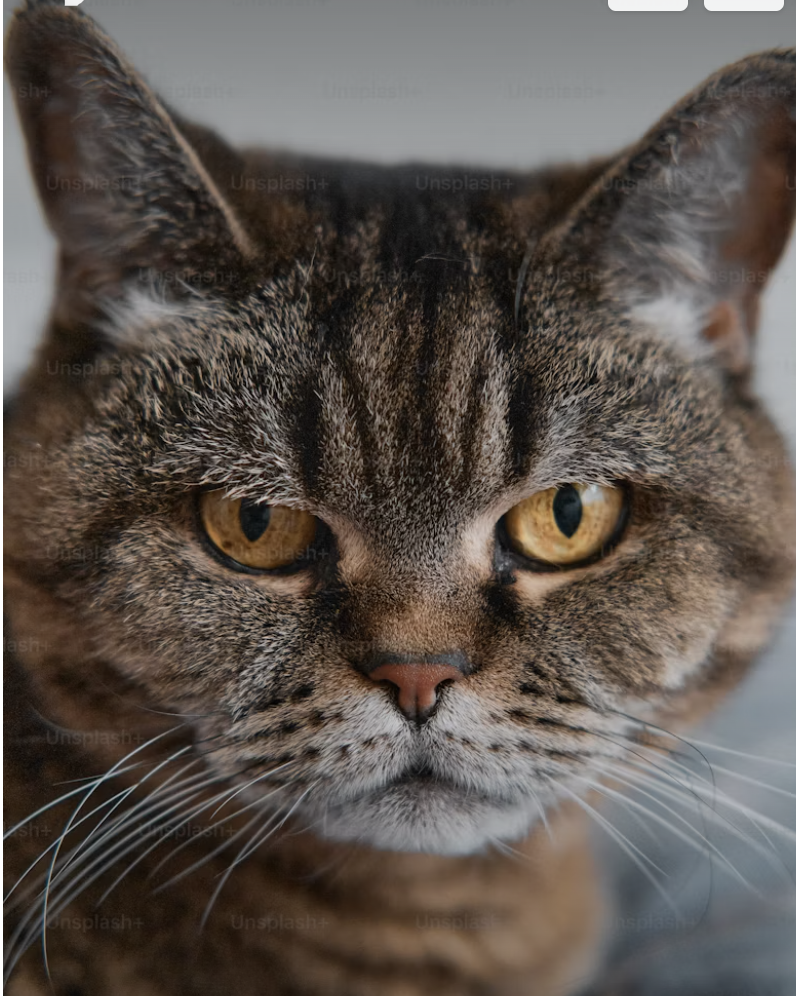

Predicted: cat
1/1 [==============================] - 0s 23ms/step


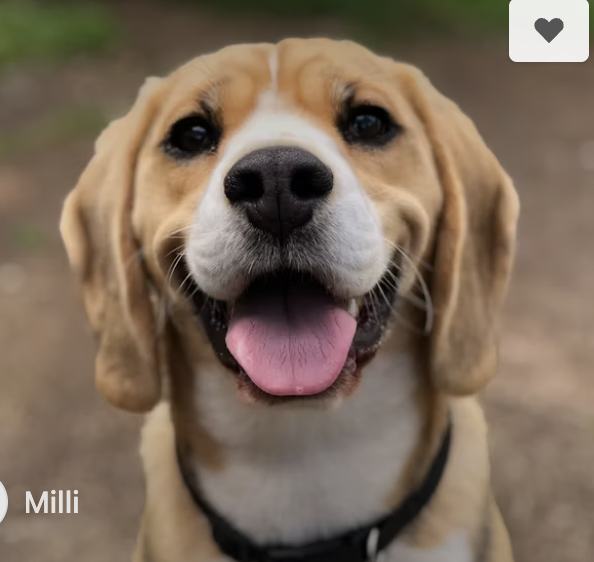

Predicted: cat
1/1 [==============================] - 0s 22ms/step


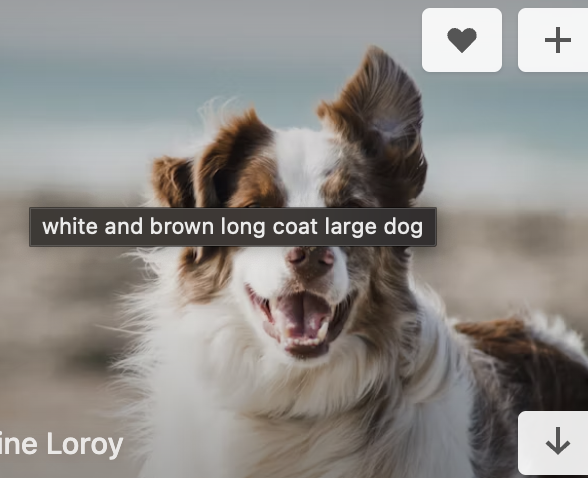

Predicted: dog
1/1 [==============================] - 0s 32ms/step


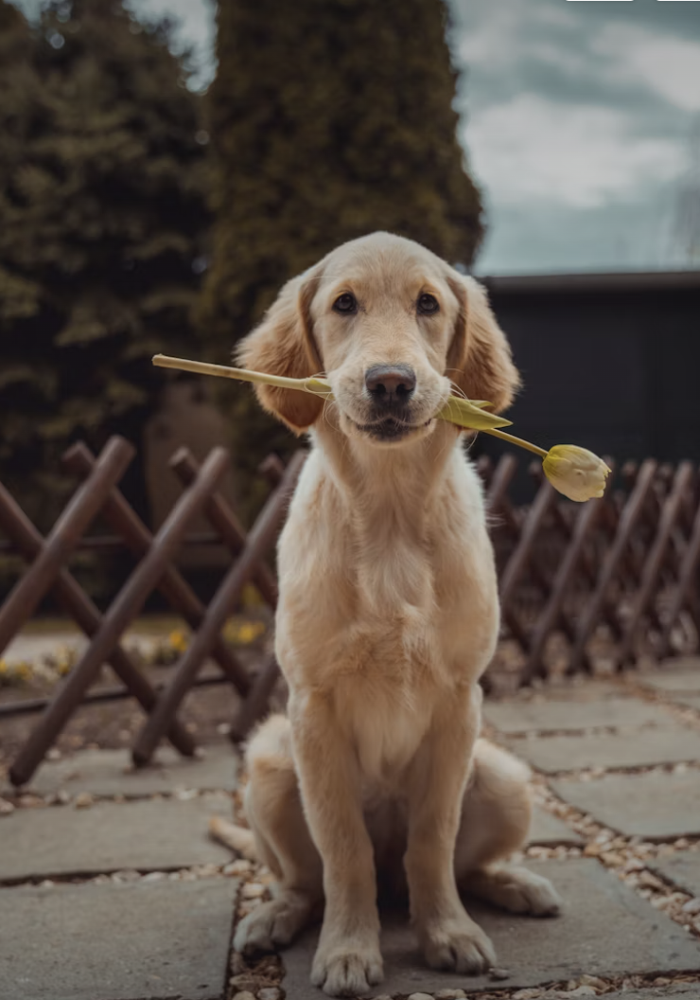

Predicted: dog
1/1 [==============================] - 0s 22ms/step


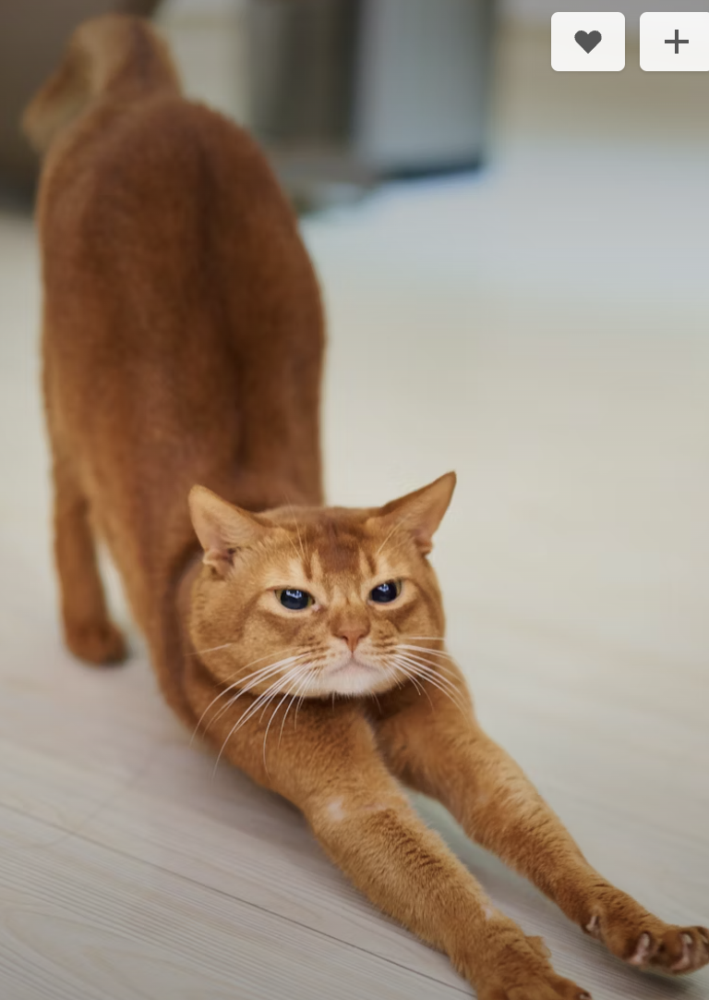

Predicted: dog
1/1 [==============================] - 0s 24ms/step


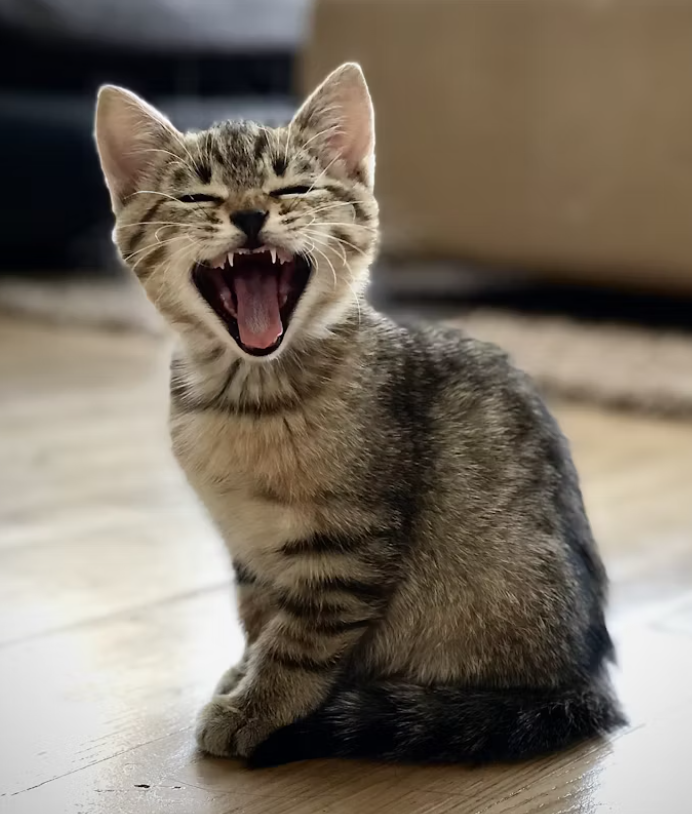

Predicted: dog
1/1 [==============================] - 0s 36ms/step


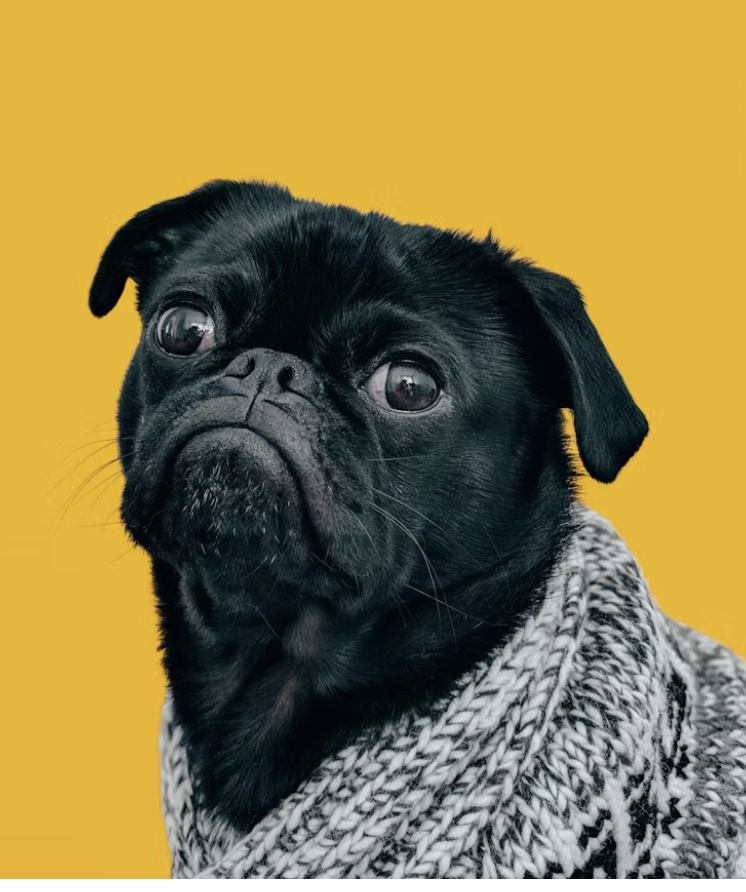

Predicted: dog
1/1 [==============================] - 0s 22ms/step


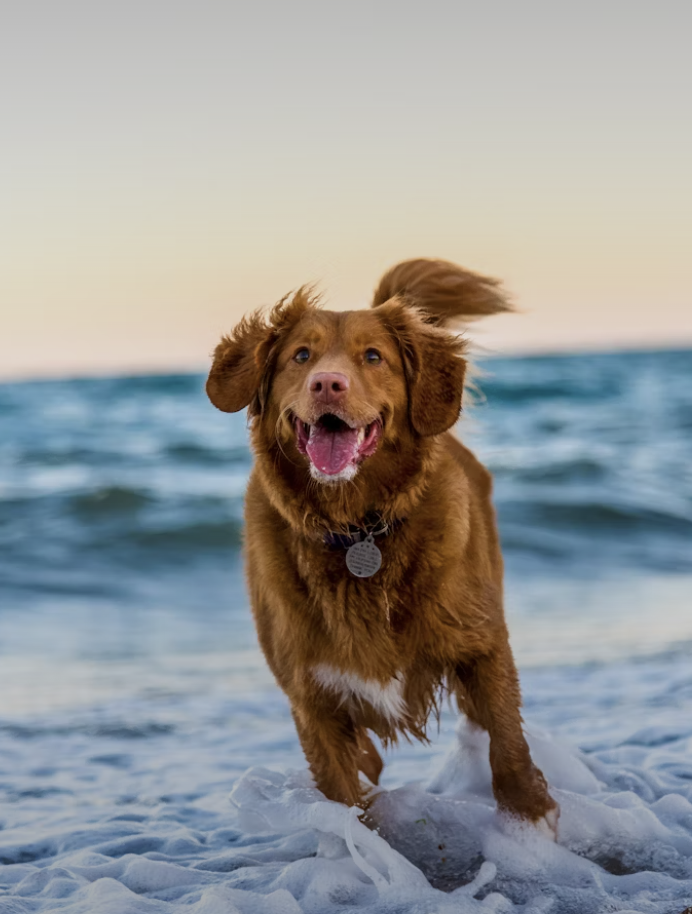

Predicted: dog
1/1 [==============================] - 0s 26ms/step


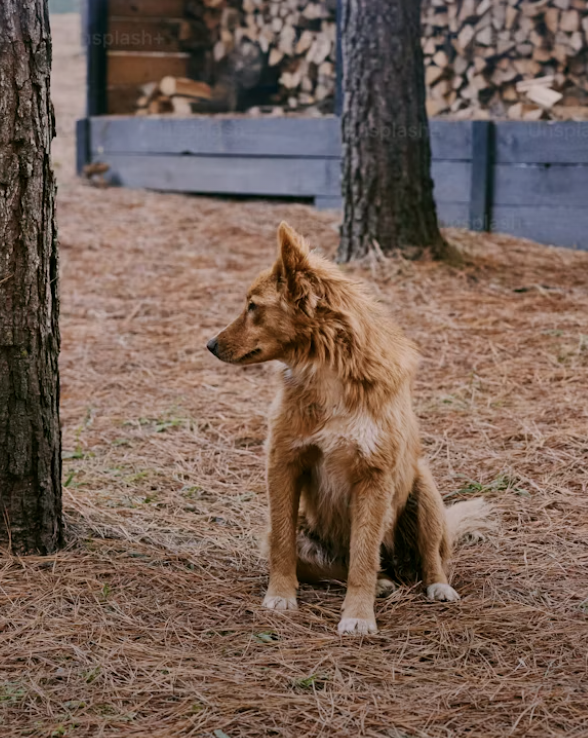

Predicted: dog
1/1 [==============================] - 0s 39ms/step


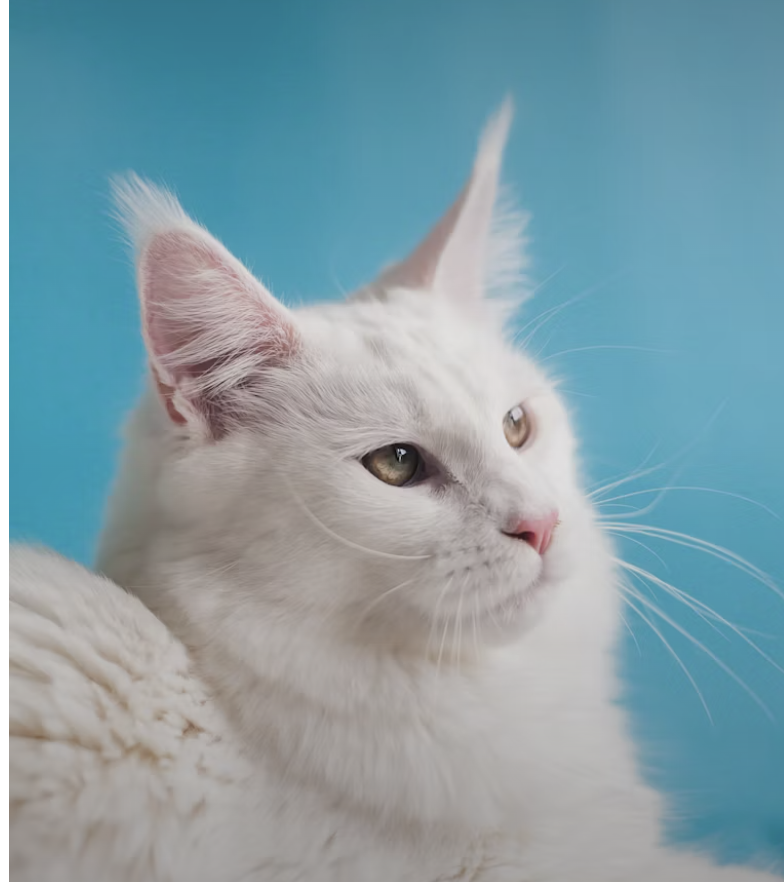

Predicted: cat


: 

In [7]:
import os
import cv2
import tensorflow as tf
import numpy as np
from tensorflow.keras.preprocessing import image
from IPython.display import Image, display

# Load the trained model
model = tf.keras.models.load_model('cat_dog_model.h5')

# Set the path to the folder containing the images
image_folder = 'Test'

# Define the class names
class_names = ['cat', 'dog']

# Loop through all files in the folder
for filename in os.listdir(image_folder):
    # Skip non-image files
    if not filename.lower().endswith(('.png', '.jpg', '.jpeg')):
        continue

    # Load and preprocess the image
    img_path = os.path.join(image_folder, filename)
    img = image.load_img(img_path, target_size=(224, 224))
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0) / 255.

    # Make a prediction
    prediction = model.predict(img_array)
    predicted_class = class_names[int(prediction[0] > 0.5)]

    # Load the image using OpenCV
    img_cv = cv2.imread(img_path)

    # Resize the image for better display
    img_cv = cv2.resize(img_cv, (400, 400))

    # Display the image with the predicted class in the notebook
    display(Image(filename=img_path))
    print(f'Predicted: {predicted_class}')

    # Display the image with the predicted class in a separate window
    cv2.imshow(filename, img_cv)
    key = cv2.waitKey(0)
    if key == ord('q'):  # Press 'q' to quit
        break
    cv2.destroyAllWindows()

# Close any remaining OpenCV windows
cv2.destroyAllWindows()